In [0]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import random
import warnings; warnings.simplefilter('ignore')
import seaborn as sns

In [3]:
cd drive/My\ Drive/Epidemic

/content/drive/My Drive/Epidemic


In [4]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

## Initialing basic parameters:
1. contact radius
2. dimensions of area of interest
3. free movement radius allowed per person per iteration
4. No. of days for which an infected person is capable of transmission
5. Number of days
6. No. of people practicing hygiene


,x,y,infected,infected_days
0,2.946650,5.305868,0,0
1,1.915208,0.679004,1,0
2,7.869855,6.563335,0,0
3,6.375209,5.756029,0,0
4,0.390629,3.578136,0,0
...,...,...,...,...
995,6.469466,9.263839,0,0
996,1.013755,5.743854,0,0
997,4.708697,4.264305,0,0
998,7.076879,6.961433,0,0


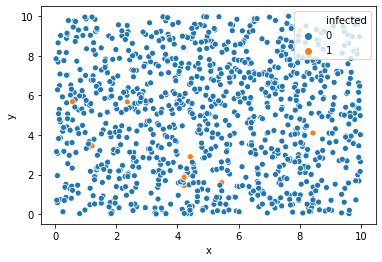

In [5]:
N = 1000
contact_radius = 0.2
model_dimn = 10
movement_dimn = 0.3
incubation = 28
initial_infected = 10
n_iterations = 100

n_hygienic = 0.4*N

#Case 0: Simple population movement without any restrition
np.random.seed(17)
P_0 = model_dimn*np.random.random_sample((N,2))
Sim_Simple = pd.DataFrame(P_0, columns=["x", "y"])

random_infected= np.random.choice(a = range(N-1), size=initial_infected, replace = False)
infected_days = np.random.randint(1, size=N)
Sim_Simple["infected"] = [1 if i in random_infected else 0 for i in range(N)]
Sim_Simple["infected_days"] = infected_days

Sim_Hygiene1 = Sim_Simple
Sim_Hygiene2 = Sim_Simple

sns.scatterplot(data=Sim_Simple, x='x', y='y', hue='infected')
#plt.scatter(df_P_0["x"],df_P_0["y"], color = df_P_0["infected"])
Sim_Hygiene1

In [0]:
random_infected

NameError: ignored

## FREE MOVEMENT

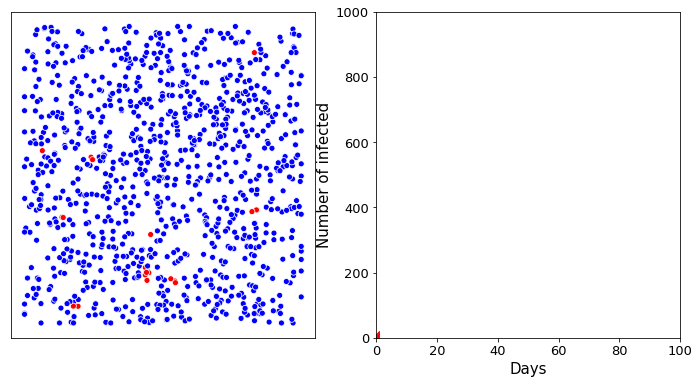

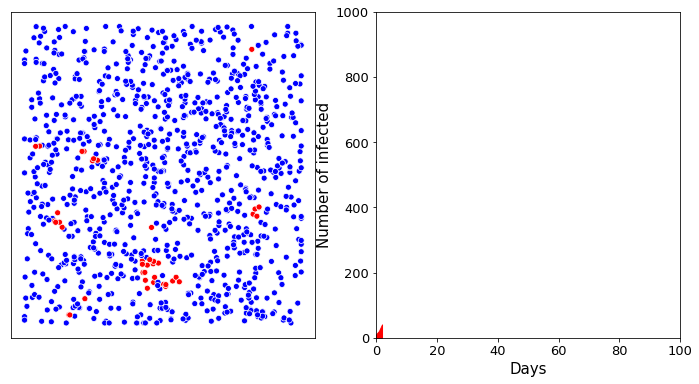

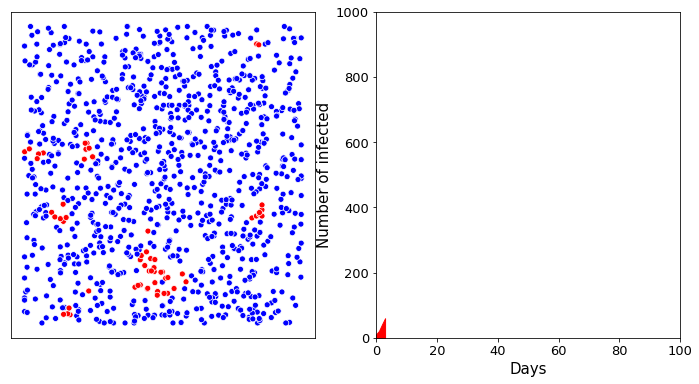

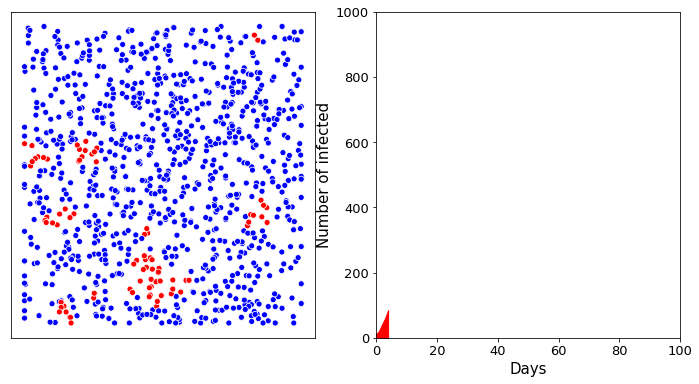

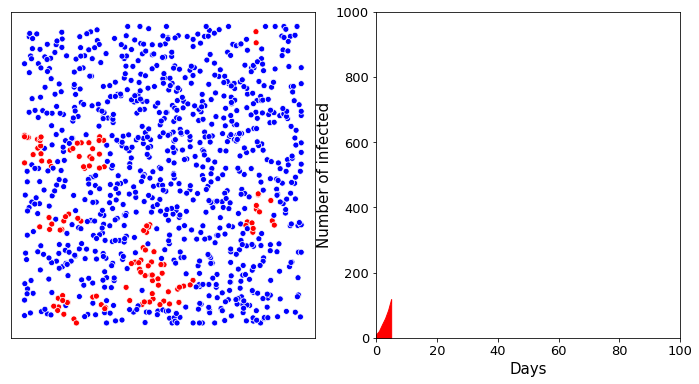

...

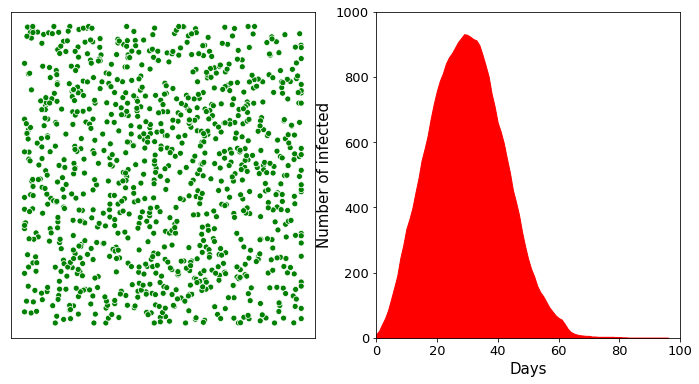

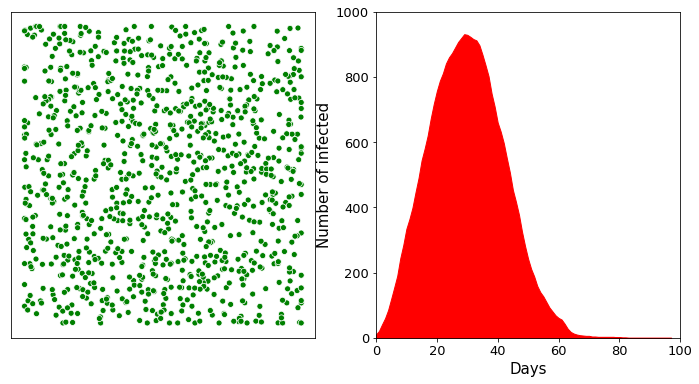

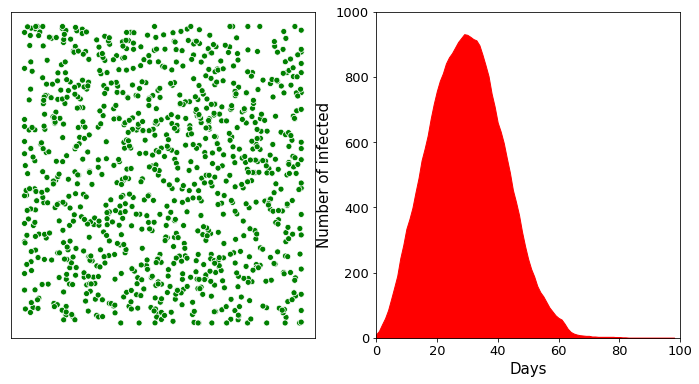

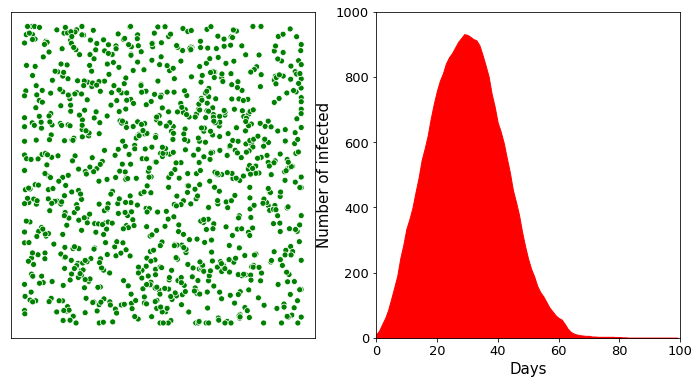

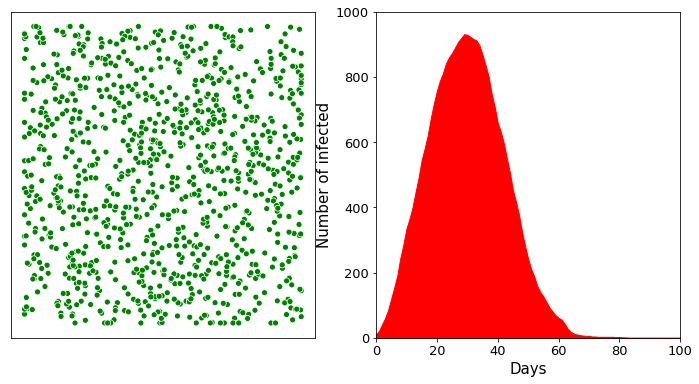

In [0]:
##### No Assumptions. Free movement. Run only to check free movement case

#infected_index = random_infected
n_infected = [initial_infected]
days = [0]
color_dict = dict({0:'blue', 1:'red',2: 'green'})

for alpha in range(n_iterations):
    #print(alpha)
    movement = 2*movement_dimn*np.random.random_sample((N,2))-movement_dimn
    Sim_Simple["x"] = Sim_Simple["x"] + movement[:,0]
    Sim_Simple["y"] = Sim_Simple["y"] + movement[:,1]
    
    infected_index = Sim_Simple.index[Sim_Simple['infected'] == 1].tolist()
    
    for i in range(N):
        if Sim_Simple.x[i]>model_dimn:
            Sim_Simple.x[i]=model_dimn
        if Sim_Simple.y[i]>model_dimn:
            Sim_Simple.y[i]=model_dimn
        if Sim_Simple.x[i]<0:
            Sim_Simple.x[i]=0
        if Sim_Simple.y[i]<0:
            Sim_Simple.y[i]=0
        
        if Sim_Simple.infected_days[i]>incubation:
            Sim_Simple.infected[i]=2
            

        if i not in infected_index and Sim_Simple.infected[i]!=2:
            for k in infected_index:
                distance = np.sqrt((Sim_Simple.x[i]-Sim_Simple.x[k])**2 + (Sim_Simple.y[i]-Sim_Simple.y[k])**2)
                if distance<=contact_radius:
                    Sim_Simple.infected[i] = 1

    n_infected.append(Sim_Simple.infected[Sim_Simple["infected"]==1].count())
    days.append(alpha+1)              
    
    for a1 in infected_index:
        Sim_Simple.infected_days[a1]= Sim_Simple.infected_days[a1] + 1
       

    fig = plt.figure(figsize=(12,6))

    plt.subplot(1, 2, 1)
    img= sns.scatterplot(data=Sim_Simple, x='x', y='y', hue='infected', palette=color_dict, legend = False)
    #plt.legend(title='status', loc='upper left', labels=['suseptible', 'infected', 'removed'])
    img.set(yticks = [])
    img.set(xticks = [])
    img.set(yticklabels = [])
    img.set(xticklabels = [])
    img.set_xlabel('')
    img.set_ylabel('')


    plt.subplot(1, 2, 2)
    plt.fill_between(days, n_infected, color = 'red')
    plt.ylim(ymax=N,ymin=0)
    plt.xlim(xmax=n_iterations,xmin=0)
    plt.ylabel('Number of infected',size=15)
    plt.xlabel('Days',size = 15)
    plt.tick_params(labelsize = 13)
    plt.savefig('img_%d.png'%(alpha),bbox_inches='tight')
    plt.show(fig)    


In [0]:

Sim_Simple
n_infected

[10,
 21,
 41,
 60,
 85,
 119,
 154,
 190,
 244,
 285,
 334,
 364,
 399,
 446,
 490,
 544,
 580,
 620,
 672,
 717,
 756,
 788,
 811,
 841,
 860,
 873,
 890,
 907,
 919,
 931,
 929,
 923,
 916,
 912,
 897,
 868,
 836,
 802,
 749,
 709,
 660,
 632,
 597,
 551,
 507,
 453,
 417,
 377,
 325,
 281,
 242,
 211,
 188,
 159,
 140,
 127,
 110,
 93,
 81,
 69,
 61,
 56,
 43,
 28,
 18,
 13,
 10,
 8,
 7,
 6,
 6,
 4,
 4,
 3,
 3,
 3,
 3,
 3,
 3,
 2,
 2,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


## Random 40% practice hygeine

In [6]:
#CASE 1: Hygeine - Assume some people practice Hygeine


np.random.seed(156)
random_hygiene= np.random.choice(a = range(N-1), size=int(n_hygienic), replace = False)

Sim_Hygiene1["hygiene"] = [1 if i in random_hygiene else 0 for i in range(N)]
np.unique(random_hygiene)

array([  0,   8,   9,  12,  15,  20,  29,  31,  35,  38,  39,  41,  42,
        44,  46,  50,  52,  56,  57,  58,  62,  64,  65,  71,  72,  73,
        75,  77,  79,  82,  84,  86,  88,  89,  90,  91,  93,  94,  96,
        97,  99, 100, 102, 105, 108, 109, 113, 114, 116, 117, 120, 121,
       129, 136, 137, 140, 146, 152, 153, 154, 157, 166, 167, 171, 173,
       175, 178, 180, 183, 187, 188, 191, 194, 196, 197, 199, 200, 201,
       204, 207, 208, 210, 212, 214, 215, 218, 220, 223, 226, 227, 228,
       233, 234, 237, 239, 240, 241, 242, 250, 253, 256, 262, 264, 266,
       267, 268, 269, 271, 273, 275, 277, 278, 284, 286, 290, 293, 295,
       301, 304, 306, 309, 310, 311, 312, 313, 318, 319, 320, 324, 326,
       328, 329, 331, 332, 336, 337, 342, 346, 347, 350, 356, 357, 358,
       364, 371, 375, 376, 379, 381, 383, 386, 387, 388, 391, 393, 394,
       402, 407, 410, 412, 414, 420, 426, 429, 434, 435, 437, 438, 441,
       442, 444, 450, 451, 452, 454, 455, 456, 457, 463, 467, 47

In [0]:
infected_index = Sim_Hygiene1.index[Sim_Hygiene1['infected'] == 1].tolist()
#infected_index

In [8]:
Sim_Hygiene1[(Sim_Hygiene1['infected']==1) & (Sim_Hygiene1['hygiene']==1)].count()

x                3
y                3
infected         3
infected_days    3
hygiene          3
dtype: int64

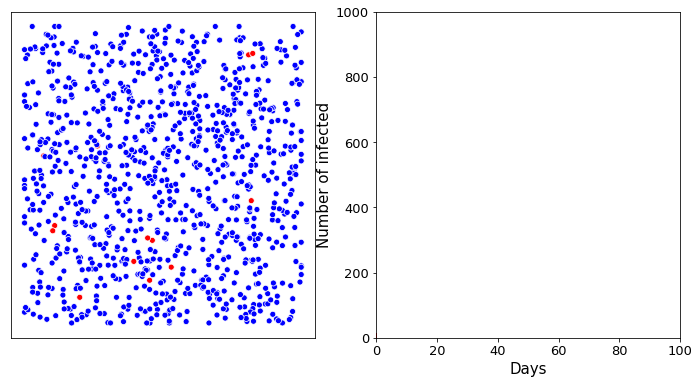

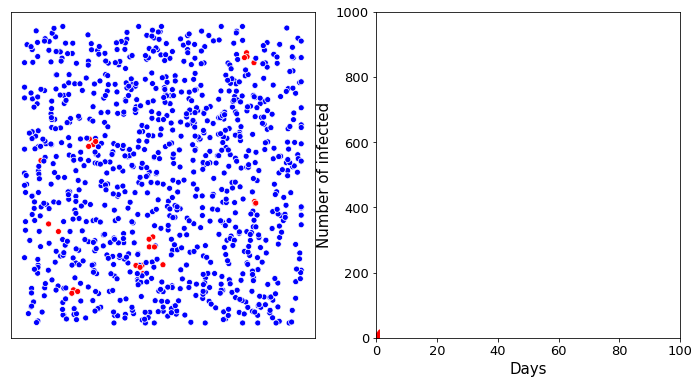

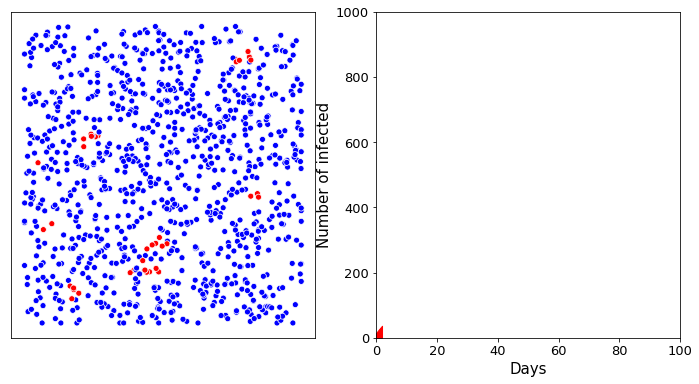

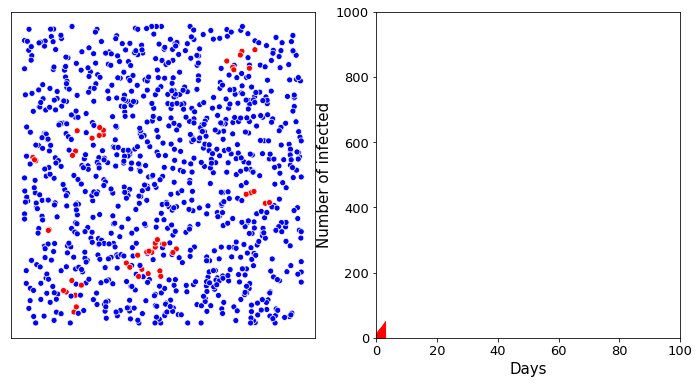

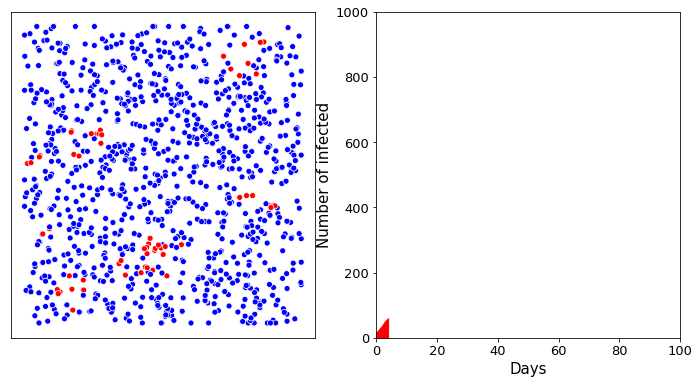

...

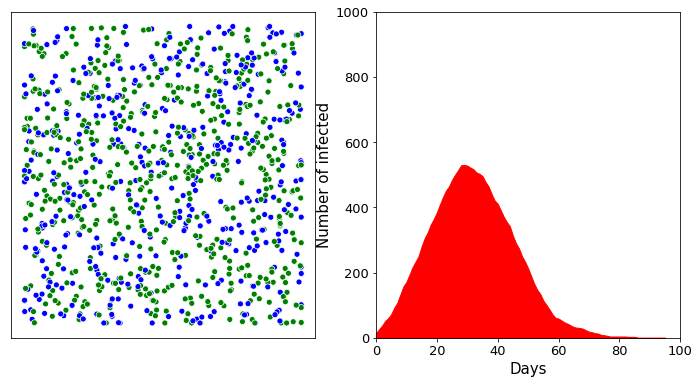

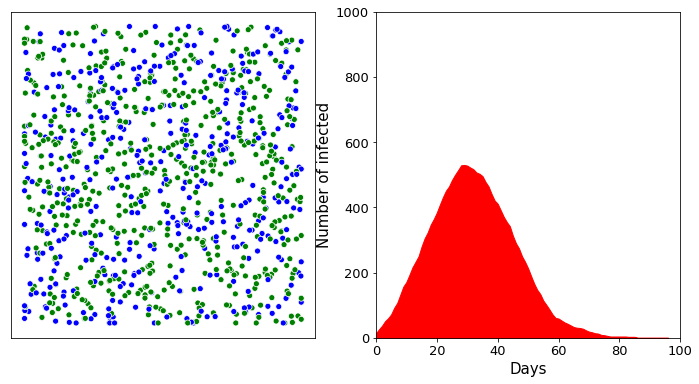

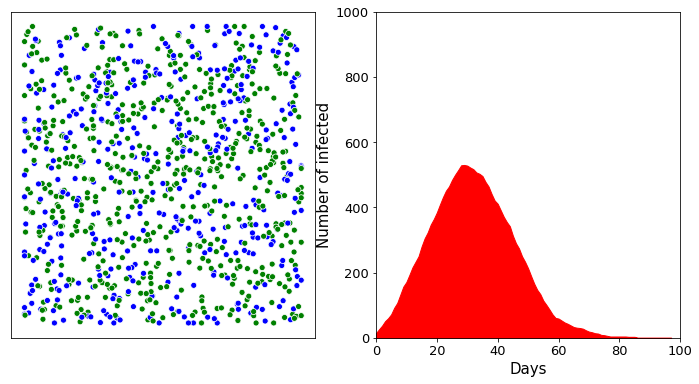

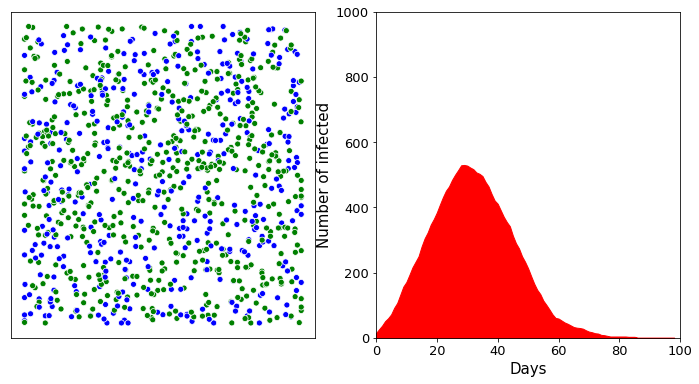

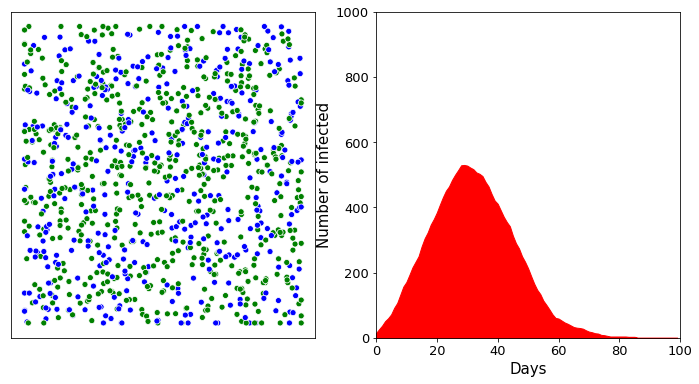

In [9]:
n_infected_hygiene = [initial_infected]
days = [0]
color_dict = dict({0:'blue', 1:'red',2: 'green'})

for alpha in range(n_iterations):
    movement = 2*movement_dimn*np.random.random_sample((N,2))-movement_dimn
    Sim_Hygiene1["x"] = Sim_Hygiene1["x"] + movement[:,0]
    Sim_Hygiene1["y"] = Sim_Hygiene1["y"] + movement[:,1]
    infected_index = Sim_Hygiene1.index[Sim_Hygiene1['infected'] == 1].tolist()
    
    for i in range(N):
        if Sim_Hygiene1.x[i]>model_dimn:
            Sim_Hygiene1.x[i]=model_dimn
        if Sim_Hygiene1.y[i]>model_dimn:
            Sim_Hygiene1.y[i]=model_dimn
        if Sim_Hygiene1.x[i]<0:
            Sim_Hygiene1.x[i]=0
        if Sim_Hygiene1.y[i]<0:
            Sim_Hygiene1.y[i]=0
        
        if Sim_Hygiene1.infected_days[i]>incubation:
            Sim_Hygiene1.infected[i]=2
        
        if Sim_Hygiene1.infected[i] == 0 and Sim_Hygiene1.hygiene[i] == 0:
            for k in infected_index:
                distance = np.sqrt((Sim_Hygiene1.x[i]-Sim_Hygiene1.x[k])**2 + (Sim_Hygiene1.y[i]-Sim_Hygiene1.y[k])**2)
                if distance<=contact_radius:
                    Sim_Hygiene1.infected[i] = 1

    n_infected_hygiene.append(Sim_Hygiene1.infected[Sim_Hygiene1["infected"]==1].count())
    days.append(alpha)              

    for a1 in infected_index:
        Sim_Hygiene1.infected_days[a1]= Sim_Hygiene1.infected_days[a1] + 1

    fig = plt.figure(figsize=(12,6))

    plt.subplot(1, 2, 1)
    img= sns.scatterplot(data=Sim_Hygiene1, x='x', y='y', hue='infected', palette=color_dict, legend = False)
    #plt.legend(title='status', loc='upper left', labels=['suseptible', 'infected', 'removed'])
    img.set(yticks = [])
    img.set(xticks = [])
    img.set(yticklabels = [])
    img.set(xticklabels = [])
    img.set_xlabel('')
    img.set_ylabel('')

    plt.subplot(1, 2, 2)
    plt.fill_between(days, n_infected_hygiene, color = 'red')
    plt.ylim(ymax=N,ymin=0)
    plt.xlim(xmax=n_iterations,xmin=0)
    plt.ylabel('Number of infected',size=15)
    plt.xlabel('Days',size = 15)
    plt.tick_params(labelsize = 13)
    plt.savefig('img_hygiene_%d.png'%(alpha),bbox_inches='tight')
    plt.show(fig)





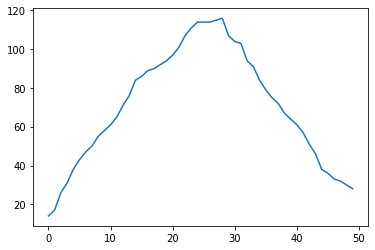

In [0]:
plt.plot(days, n_infected_hygiene) 

## Lockdown


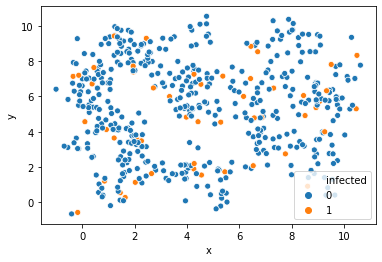

In [0]:
#lockdown

from sklearn.datasets.samples_generator import make_blobs

N = 500
contact_radius = 0.4
model_dimn = 10
movement_dimn = 0.5
incubation = 28


n_hygienic = 0.4*N

n_iterations = 3
initial_infected = 50
n_society = 50
people_per_soc = int(N/n_society)
society_std = 0.5
np.random.seed(34)
X, y = make_blobs(n_samples=N, cluster_std = society_std, center_box = (0,model_dimn), centers=n_society, n_features=2, random_state=1)
Sim_data = np.hstack((X,y.reshape((N,1))))


Sim_lockdown = pd.DataFrame(Sim_data, columns=["x", "y", "SocietyIndex"])

random_infected= np.random.choice(a = range(N-1), size=initial_infected, replace = False)
random_hygiene= np.random.choice(a = range(N-1), size=int(n_hygienic), replace = False)
Sim_lockdown["infected"] = [1 if i in random_infected else 0 for i in range(N)]
Sim_lockdown["infected_days"] = np.random.randint(1, size=N)
Sim_lockdown["hygiene"] = [1 if i in random_hygiene else 0 for i in range(N)]
Sim_lockdown.sort_values(by = ['SocietyIndex'], inplace = True)
Sim_lockdown.reset_index(drop = True, inplace = True)

sns.scatterplot(data=Sim_lockdown, x='x', y='y', hue='infected')


In [0]:
Sim_lockdown

,x,y,SocietyIndex,infected,infected_days,hygiene
0,4.263501,7.408271,0.0,0,0,0
1,3.834889,7.392027,0.0,0,0,0
2,4.269370,7.262749,0.0,1,0,0
3,4.017118,7.617232,0.0,0,0,1
4,4.328038,6.192144,0.0,0,0,0
...,...,...,...,...,...,...
495,-0.302243,6.300965,49.0,0,0,0
496,-0.091647,5.743613,49.0,0,0,1
497,0.454598,6.988750,49.0,0,0,0
498,-0.098723,6.100994,49.0,0,0,1


In [0]:
#3 Markets
#societyindex = 100

markets = [[5,4,100,0,0,0,5,4],[2,6,100,0,0,0,2,6],[8,5,100,0,0,0,8,5]]

df_markets = pd.DataFrame(markets, columns=["x", "y", "SocietyIndex", "infected", "infected_days", "hygiene", 
                                            "closest_market_x", "closest_market_y"])

Sim_lockdown["closest_market_x"] = [0 for i in range(N)]
Sim_lockdown["closest_market_y"] = [0 for i in range(N)]

for i in range(N):
    d1 = np.sqrt((Sim_lockdown.x[i]-df_markets.x[0])**2 + (Sim_lockdown.y[i]-df_markets.y[0])**2)
    d2 = np.sqrt((Sim_lockdown.x[i]-df_markets.x[1])**2 + (Sim_lockdown.y[i]-df_markets.y[1])**2)
    d3 = np.sqrt((Sim_lockdown.x[i]-df_markets.x[2])**2 + (Sim_lockdown.y[i]-df_markets.y[2])**2)
    
    if min(d1,d2,d3) == d1:
        Sim_lockdown.closest_market_x[i] = df_markets.x[0]
        Sim_lockdown.closest_market_y[i] = df_markets.y[0]
    if min(d1,d2,d3) == d2:
        Sim_lockdown.closest_market_x[i] = df_markets.x[1]
        Sim_lockdown.closest_market_y[i] = df_markets.y[1]
    if min(d1,d2,d3) == d3:
        Sim_lockdown.closest_market_x[i] = df_markets.x[2]
        Sim_lockdown.closest_market_y[i] = df_markets.y[2]
        
Sim_lockdown = pd.concat([Sim_lockdown,df_markets])
Sim_lockdown.reset_index(drop = True, inplace = True)
Sim_lockdown_1 = Sim_lockdown.copy()
#Sim_lockdown_1

In [0]:
Sim_lockdown

,x,y,SocietyIndex,infected,infected_days,hygiene,closest_market_x,closest_market_y
0,4.263501,7.408271,0.0,0,0,0,2,6
1,3.834889,7.392027,0.0,0,0,0,2,6
2,4.269370,7.262749,0.0,1,0,0,2,6
3,4.017118,7.617232,0.0,0,0,1,2,6
4,4.328038,6.192144,0.0,0,0,0,5,4
...,...,...,...,...,...,...,...,...
498,-0.098723,6.100994,49.0,0,0,1,2,6
499,-0.995397,6.413391,49.0,0,0,0,2,6
500,5.000000,4.000000,100.0,0,0,0,5,4
501,2.000000,6.000000,100.0,0,0,0,2,6


In [0]:
np.random.seed(273)
#societyfirstindex = np.arange(start=0, stop=200, step=people_per_soc) #lowest index number for each society
n_people_out = int(0.1*N) # no of people going out each day 
n_infected_lockdown = [initial_infected]
days = [0]
color_dict = dict({0:'blue', 1:'red',2: 'green'})

 #creating a copy of initial coordinates 
#                              of each person to restore it in the end of each iteration/day 

for alpha in range(n_iterations): #interations/days
    #print(alpha)
    
    #select random person from each society
    marketgoing = np.random.choice(a = range(N-1), size=n_people_out, replace = False)
    
    #print('marketgoing=>{}'.format(marketgoing)) # select 10 people to go to market
    infected_index = Sim_lockdown.index[Sim_lockdown['infected'] == 1].tolist() #list of infected people(entire 
    #print('InfInd')
    #print(infected_index)
    arr = list(set(infected_index) & set(marketgoing))                                                                         #list updates every iteration)
    print(arr)
    for i in range(len(Sim_lockdown)):
        #print('i={}'.format(i))
        
        if i in marketgoing: 
            Sim_lockdown.x[i] = Sim_lockdown.closest_market_x[i]
            Sim_lockdown.y[i] = Sim_lockdown.closest_market_y[i]
        

        if Sim_lockdown.x[i]>model_dimn:
            Sim_lockdown.x[i]=model_dimn
        if Sim_lockdown.y[i]>model_dimn:
            Sim_lockdown.y[i]=model_dimn
        if Sim_lockdown.x[i]<0:
            Sim_lockdown.x[i]=0
        if Sim_lockdown.y[i]<0:
            Sim_lockdown.y[i]=0
        
        if Sim_lockdown.infected_days[i]>incubation:
            Sim_lockdown.infected[i]=2
        
        if Sim_lockdown.infected[i] == 0 and Sim_lockdown.hygiene[i] == 0:
            for k in infected_index:
                distance = np.sqrt((Sim_lockdown.x[i]-Sim_lockdown.x[k])**2 + (Sim_lockdown.y[i]-Sim_lockdown.y[k])**2)
                if i>499:
                  print('dist1={},k= {},i={}'.format(distance,k,i))
                if distance<=contact_radius:
                  Sim_lockdown.infected[i] = 1
        
        Sim_lockdown.x[i]= Sim_lockdown_1.x[i]
        Sim_lockdown.y[i]= Sim_lockdown_1.y[i]
        
    n_infected_lockdown.append(Sim_lockdown.infected[Sim_lockdown["infected"]==1].count())
    days.append(alpha)              

    for a1 in infected_index:
        Sim_lockdown.infected_days[a1]= Sim_lockdown.infected_days[a1] + 1
    
    
# fig = plt.figure(figsize=(12,6))

# plt.subplot(1, 2, 1)
# img= sns.scatterplot(data=Sim_lockdown, x='x', y='y', hue='infected', palette=color_dict, legend = False)
# #plt.scatter([5,2,8],[4,6,5], color = 'black')
# #plt.legend(title='status', loc='upper left', labels=['suseptible', 'infected', 'removed'])
# img.set(yticks = [])
# img.set(xticks = [])
# img.set(yticklabels = [])
# img.set(xticklabels = [])
# img.set_xlabel('')
# img.set_ylabel('')


# plt.subplot(1, 2, 2)
# plt.fill_between(days, n_infected_lockdown, color = 'red')
# plt.ylabel('Number of infected')
# plt.xlabel('Days')
# plt.show(fig)

[161, 169, 78, 371, 53, 181]
dist1=3.343553954827679,k= 2,i=500
dist1=4.95639945459932,k= 22,i=500
dist1=4.13285824714588,k= 25,i=500
dist1=5.020362857083853,k= 27,i=500
dist1=5.004902020953786,k= 28,i=500
dist1=2.9117599148435938,k= 31,i=500
dist1=2.7856432546684475,k= 34,i=500
dist1=1.3160506655651387,k= 47,i=500
dist1=2.732670990844354,k= 53,i=500
dist1=5.884599509418856,k= 63,i=500
dist1=6.2000099508281865,k= 78,i=500
dist1=2.6012910515038725,k= 88,i=500
dist1=3.3715320000739375,k= 111,i=500
dist1=6.906019340903872,k= 130,i=500
dist1=4.556322411149459,k= 141,i=500
dist1=4.07639084538686,k= 150,i=500
dist1=4.927396428698342,k= 154,i=500
dist1=5.611982658498059,k= 160,i=500
dist1=4.157767113045024,k= 161,i=500
dist1=3.625436515566366,k= 165,i=500
dist1=4.420111994061662,k= 169,i=500
dist1=5.055888356560028,k= 181,i=500
dist1=4.847179541102988,k= 186,i=500
dist1=6.048444927675812,k= 198,i=500
dist1=6.992574566255843,k= 201,i=500
dist1=5.90583995377134,k= 208,i=500
dist1=3.344490090396

In [0]:
#plt.plot(days, n_infected_lockdown) 
Sim_lockdown

,x,y,SocietyIndex,infected,infected_days,hygiene,closest_market_x,closest_market_y
0,4.263501,7.408271,0.0,1,3,0,2,6
1,3.834889,7.392027,0.0,0,0,0,2,6
2,4.269370,7.262749,0.0,1,6,0,2,6
3,4.017118,7.617232,0.0,0,0,1,2,6
4,4.328038,6.192144,0.0,0,0,0,5,4
...,...,...,...,...,...,...,...,...
498,-0.098723,6.100994,49.0,0,0,1,2,6
499,-0.995397,6.413391,49.0,1,4,0,2,6
500,5.000000,4.000000,100.0,0,0,0,5,4
501,2.000000,6.000000,100.0,0,0,0,2,6


In [0]:
#Sim_lockdown_1